# Exploratory Data Analysis para datos de Temperatura


## Importando librerías y variables de entorno


In [1]:
import pandas as pd
from azure.data.tables import TableClient
import os
from dotenv import load_dotenv, find_dotenv
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.impute import KNNImputer
import folium
import geopandas as gpd
from folium.plugins import MarkerCluster
import dash
from dash import dcc, html
from dash.dependencies import Input, Output
from statsmodels.tsa.seasonal import seasonal_decompose
from sklearn.impute import SimpleImputer

In [2]:
load_dotenv(find_dotenv())

True

In [3]:
connection_string = os.getenv("AZ_CONNECTION_STRING")

## Leyendo Datos


In [4]:
## Definiendo funciones:


# Crear conexión de una tabla específica dentro del servicio de Azure Table Storage
def set_table_service(connection_string, table):
    """Crear servicio de conexión a Azure Table Storage"""
    return TableClient.from_connection_string(
        conn_str=connection_string, table_name=table
    )


# Obtener datos de Table Storage
def get_data_from_table_storage_table(table_service, filter_query):
    """Recuperar datos de Table Storage"""
    for record in table_service.query_entities(filter_query):
        yield record


# Crear DataFrame con los datos de la tabla consultada
def get_dataframe_from_table_storage_table(table_service, filter_query):
    """Crear un DataFrame con la data del Table Storage"""
    return pd.DataFrame(get_data_from_table_storage_table(table_service, filter_query))

In [5]:
table_name_trm = "TEMPERATURACurated"
filterQuery = "PartitionKey ne 'random'"

In [6]:
# Creando DataFrame con Temperatura Data
table_service_temperatura = set_table_service(connection_string, table_name_trm)
df_temperatura = get_dataframe_from_table_storage_table(
    table_service_temperatura, filterQuery
)

print(f"Shape: {df_temperatura.shape}")
print(f"dtypes: {df_temperatura.dtypes}")
df_temperatura.head()

Shape: (182761, 16)
dtypes: PartitionKey          object
RowKey                object
TimeStamp              int64
codigoestacion        object
codigosensor          object
date                  object
departamento          object
descripcionsensor     object
latitud               object
longitud              object
municipio             object
nombreestacion        object
temp_max             float64
temp_min             float64
unidadmedida          object
zonahidrografica      object
dtype: object


,PartitionKey,RowKey,TimeStamp,codigoestacion,codigosensor,date,departamento,descripcionsensor,latitud,longitud,municipio,nombreestacion,temp_max,temp_min,unidadmedida,zonahidrografica
0,DefaultPartitionKey,00004632-074c-49c5-ada2-0d80acc76753,20231103,0023025502,0068,2023-02-13T00:00:00.000,CALDAS,Temp Aire 2 m,5.044997222,-75.33221944,MANIZALES,ALMACAFE LETRAS - AUT,11.76996,3.194234,°C,MEDIO MAGDALENA
1,DefaultPartitionKey,00006165-52f2-4ddb-86bc-928e0e7d5270,20231104,0024025050,0068,2021-02-16T00:00:00.000,SANTANDER,Temp Aire 2 m,6.274,-73.151,CHARALÁ,CHARALA - ISAGEN - Estacion en Pruebas,28.70000,16.900000,°C,SOGAMOSO
2,DefaultPartitionKey,0000c881-f422-45e6-b3a7-d80ed727431b,20231104,0016025503,0068,2022-08-03T00:00:00.000,NORTE DE SANTANDER,Temp Aire 2 m,7.923163889,-72.83375556,GRAMALOTE,GRAMALOTE - AUT,22.89349,15.377090,°C,CATATUMBO
3,DefaultPartitionKey,0000f7fd-1700-4e21-aacf-884faf159ef5,20231104,0026125502,0068,2022-07-23T00:00:00.000,VALLE DEL CAUCA,Temp Aire 2 m,4.297558333,-75.86396111,CAICEDONIA,CAICEDONIA - AUT,25.46039,17.622430,°C,CAUCA
4,DefaultPartitionKey,0001598f-192a-4d55-bf47-fda975ba6f14,20231104,0035080050,0068,2022-04-04T00:00:00.000,BOYACÁ,Temp Aire 2 m,5.096,-73.053,PÁEZ,PAEZ,23.45000,17.940000,°C,META


## Preprocesando los datos


### Conservando y Transformado Columnas Relevantes


In [7]:
df_temperatura.columns

Index(['PartitionKey', 'RowKey', 'TimeStamp', 'codigoestacion', 'codigosensor',
       'date', 'departamento', 'descripcionsensor', 'latitud', 'longitud',
       'municipio', 'nombreestacion', 'temp_max', 'temp_min', 'unidadmedida',
       'zonahidrografica'],
      dtype='object')

In [8]:
columns_to_keep = [
    "date",
    "departamento",
    "municipio",
    "latitud",
    "longitud",
    "temp_max",
    "temp_min",
]

df_temperatura = df_temperatura[columns_to_keep]
df_temperatura.head()

,date,departamento,municipio,latitud,longitud,temp_max,temp_min
0,2023-02-13T00:00:00.000,CALDAS,MANIZALES,5.044997222,-75.33221944,11.76996,3.194234
1,2021-02-16T00:00:00.000,SANTANDER,CHARALÁ,6.274,-73.151,28.70000,16.900000
2,2022-08-03T00:00:00.000,NORTE DE SANTANDER,GRAMALOTE,7.923163889,-72.83375556,22.89349,15.377090
3,2022-07-23T00:00:00.000,VALLE DEL CAUCA,CAICEDONIA,4.297558333,-75.86396111,25.46039,17.622430
4,2022-04-04T00:00:00.000,BOYACÁ,PÁEZ,5.096,-73.053,23.45000,17.940000


In [9]:
# formateando columna date
df_temperatura[df_temperatura["date"].str.contains("T") == False]

,date,departamento,municipio,latitud,longitud,temp_max,temp_min


Todas las fechas tienen el formato "YYYY-MM-DDTHH:mm:ss:mss" por lo que se debe transformar para conservar solo la fecha sin horas


In [10]:
df_temperatura["date"].apply(lambda x: x.split("T")[0])

0         2023-02-13
1         2021-02-16
2         2022-08-03
3         2022-07-23
4         2022-04-04
             ...    
182756    2022-09-13
182757    2022-10-28
182758    2021-04-12
182759    2021-02-01
182760    2022-01-23
Name: date, Length: 182761, dtype: object

In [11]:
df_temperatura["date"] = df_temperatura["date"].apply(lambda x: x.split("T")[0])
df_temperatura.head()

,date,departamento,municipio,latitud,longitud,temp_max,temp_min
0,2023-02-13,CALDAS,MANIZALES,5.044997222,-75.33221944,11.76996,3.194234
1,2021-02-16,SANTANDER,CHARALÁ,6.274,-73.151,28.70000,16.900000
2,2022-08-03,NORTE DE SANTANDER,GRAMALOTE,7.923163889,-72.83375556,22.89349,15.377090
3,2022-07-23,VALLE DEL CAUCA,CAICEDONIA,4.297558333,-75.86396111,25.46039,17.622430
4,2022-04-04,BOYACÁ,PÁEZ,5.096,-73.053,23.45000,17.940000


### Formateando tipo de datos


In [12]:
df_temperatura["date"] = pd.to_datetime(df_temperatura["date"])
df_temperatura.dtypes

date            datetime64[ns]
departamento            object
municipio               object
latitud                 object
longitud                object
temp_max               float64
temp_min               float64
dtype: object

### Formateando nombre de departamentos


In [13]:
print(len(df_temperatura.sort_values(by="departamento").departamento.unique()))
df_temperatura.sort_values(by="departamento").departamento.unique()

42


array(['AMAZONAS', 'ANTIOQUIA', 'ARAUCA',
       'ARCHIPIELAGO DE SAN ANDRES, PROVIDENCIA Y SANTA CATALINA',
       'ARCHIPIÉLAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA',
       'ATLANTICO', 'ATLÁNTICO', 'BOGOTA', 'BOGOTA D.C.', 'BOGOTÁ',
       'BOLIVAR', 'BOLÍVAR', 'BOYACÁ', 'CALDAS', 'CAQUETA', 'CAQUETÁ',
       'CASANARE', 'CAUCA', 'CESAR', 'CHOCO', 'CHOCÓ', 'CORDOBA',
       'CUNDINAMARCA', 'CÓRDOBA', 'GUAINÍA', 'GUAVIARE', 'HUILA',
       'LA GUAJIRA', 'MAGDALENA', 'META', 'NARINO', 'NARIÑO',
       'NORTE DE SANTANDER', 'PUTUMAYO', 'QUINDÍO', 'RISARALDA',
       'SAN ANDRÉS PROVIDENCIA', 'SANTANDER', 'SUCRE', 'TOLIMA',
       'VALLE DEL CAUCA', 'VICHADA'], dtype=object)

Se identifican departamentos duplicados por errores en su escritura. Para solucionar esto, se van a eliminar tildes y la palabra "D.C".


In [14]:
dict_to_replace_dpto = {"Á": "A", "É": "E", "Í": "I", "Ó": "O", "Ú": "U", "D.C": ""}

# Apply the replacement using the dictionary
for letter, replacement in dict_to_replace_dpto.items():
    df_temperatura["departamento"] = df_temperatura["departamento"].apply(
        lambda x: x.replace(letter, replacement)
    )


df_temperatura.sort_values(by="departamento").departamento.unique()

array(['AMAZONAS', 'ANTIOQUIA', 'ARAUCA',
       'ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA',
       'ARCHIPIELAGO DE SAN ANDRES, PROVIDENCIA Y SANTA CATALINA',
       'ATLANTICO', 'BOGOTA', 'BOGOTA .', 'BOLIVAR', 'BOYACA', 'CALDAS',
       'CAQUETA', 'CASANARE', 'CAUCA', 'CESAR', 'CHOCO', 'CORDOBA',
       'CUNDINAMARCA', 'GUAINIA', 'GUAVIARE', 'HUILA', 'LA GUAJIRA',
       'MAGDALENA', 'META', 'NARINO', 'NARIÑO', 'NORTE DE SANTANDER',
       'PUTUMAYO', 'QUINDIO', 'RISARALDA', 'SAN ANDRES PROVIDENCIA',
       'SANTANDER', 'SUCRE', 'TOLIMA', 'VALLE DEL CAUCA', 'VICHADA'],
      dtype=object)

Finalmente, se borra los caracteres ",", "." y se quitan los espacios al final del texto.


In [15]:
df_temperatura["departamento"] = df_temperatura["departamento"].apply(
    lambda x: x.replace(".", "")
)
df_temperatura["departamento"] = df_temperatura["departamento"].apply(
    lambda x: x.replace(",", "")
)
df_temperatura["departamento"] = df_temperatura["departamento"].apply(
    lambda x: x.replace("Ñ", "N")
)
df_temperatura.loc[df_temperatura["departamento"].str.contains("SAN ANDRES PROVIDENCIA",case=False), "departamento"]="ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA"
df_temperatura["departamento"] = df_temperatura["departamento"].str.strip()

print(len(df_temperatura.sort_values(by="departamento").departamento.unique()))
df_temperatura.sort_values(by="departamento").departamento.unique()

32


array(['AMAZONAS', 'ANTIOQUIA', 'ARAUCA',
       'ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA',
       'ATLANTICO', 'BOGOTA', 'BOLIVAR', 'BOYACA', 'CALDAS', 'CAQUETA',
       'CASANARE', 'CAUCA', 'CESAR', 'CHOCO', 'CORDOBA', 'CUNDINAMARCA',
       'GUAINIA', 'GUAVIARE', 'HUILA', 'LA GUAJIRA', 'MAGDALENA', 'META',
       'NARINO', 'NORTE DE SANTANDER', 'PUTUMAYO', 'QUINDIO', 'RISARALDA',
       'SANTANDER', 'SUCRE', 'TOLIMA', 'VALLE DEL CAUCA', 'VICHADA'],
      dtype=object)

### Revisando si hay Missing Values


In [16]:
for column in list(df_temperatura.columns):
    print(df_temperatura[column].isna().value_counts())
    print("")

date
False    182761
Name: count, dtype: int64

departamento
False    182761
Name: count, dtype: int64

municipio
False    182761
Name: count, dtype: int64

latitud
False    182761
Name: count, dtype: int64

longitud
False    182761
Name: count, dtype: int64

temp_max
False    182761
Name: count, dtype: int64

temp_min
False    182761
Name: count, dtype: int64



Se identifica que no hay Missing Values


### Analizando Coherencia de los datos


#### Distribución de temperatura mínima y máxima


In [17]:
px.box(df_temperatura, x="temp_min", title="Distribución de la temperatura mínima")

In [18]:
px.box(df_temperatura, x="temp_max", title="Distribución de la temperatura máxima")

No se considera que hayan valores atípicos, es decir, no hay temperaturas altas o bajas en extremo que no se puedan dar el Colombia.


In [19]:
px.box(df_temperatura, x="date", title="Distribución de la fecha")

### Analizando la temperatura en el tiempo


##### Temperatura mínima, máxima y promedio por fecha


In [20]:
df_temperatura["temp_prom"] = df_temperatura[["temp_min", "temp_max"]].mean(axis=1)

In [21]:
df_temperatura_promedio_fecha = (
    df_temperatura.groupby("date")[["temp_min", "temp_max","temp_prom"]].mean().reset_index()
)
px.line(
    df_temperatura_promedio_fecha,
    y=["temp_min", "temp_max","temp_prom"],
    x="date",
    title="Evolución de la temperatura mínima y máxima promedio en el tiempo",
)

In [22]:
df_temperatura_media_fecha = (
    df_temperatura.groupby("date")[["temp_min", "temp_max","temp_prom"]].median().reset_index()
)
px.line(
    df_temperatura_media_fecha,
    y=["temp_min", "temp_max","temp_prom"],
    x="date",
    title="Evolución de la temperatura mínima y máxima media en el tiempo",
)

##### Temperatura mínima y máxima por Año y Mes


In [23]:
df_temperatura_promedio_fecha["year"] = df_temperatura_promedio_fecha[
    "date"
].dt.year.astype(
    str
)  # Creando columna Year
df_temperatura_promedio_fecha["month"] = (
    df_temperatura_promedio_fecha["date"].astype(str).apply(lambda x: x.split("-")[1])
)  # Creando columna Month
df_temperatura_promedio_fecha["Year-Month"] = (
    df_temperatura_promedio_fecha["year"] + "-" + df_temperatura_promedio_fecha["month"]
)  # Creando columna year-Month
print(df_temperatura_promedio_fecha.dtypes)
df_temperatura_promedio_fecha.head()

date          datetime64[ns]
temp_min             float64
temp_max             float64
temp_prom            float64
year                  object
month                 object
Year-Month            object
dtype: object


,date,temp_min,temp_max,temp_prom,year,month,Year-Month
0,2021-01-01,17.055835,26.006617,21.531226,2021,01,2021-01
1,2021-01-02,17.077842,25.958292,21.518067,2021,01,2021-01
2,2021-01-03,16.870172,25.501752,21.185962,2021,01,2021-01
3,2021-01-04,16.221484,21.346655,18.784070,2021,01,2021-01
4,2021-01-09,16.867825,24.075001,20.471413,2021,01,2021-01


In [24]:
df_temperatura_promedio_añomes = (
    df_temperatura_promedio_fecha.groupby(["year", "month", "Year-Month"])[
        ["temp_min", "temp_max","temp_prom"]
    ]
    .mean()
    .reset_index()
)
df_temperatura_promedio_añomes.head()

,year,month,Year-Month,temp_min,temp_max,temp_prom
0,2021,01,2021-01,15.952946,26.433207,21.193077
1,2021,02,2021-02,16.445857,26.204078,21.324968
2,2021,03,2021-03,15.475463,23.974309,19.724886
3,2021,04,2021-04,15.998253,24.127287,20.062770
4,2021,05,2021-05,16.102511,23.569932,19.836221


In [25]:
px.line(
    df_temperatura_promedio_añomes,
    y=["temp_min", "temp_max","temp_prom"],
    x="Year-Month",
    title="Evolución de la temperatura mínima y máxima promedio en el tiempo",
)

In [26]:
px.line(
    df_temperatura_promedio_añomes,
    y=["temp_min", "temp_max","temp_prom"],
    x="month",
    color="year",
    title="Evolución de la temperatura mínima y máxima promedio en el tiempo",
)

In [27]:
df_temperatura["year"] = df_temperatura["date"].dt.year.astype(
    str
)  # Creando columna Year
df_temperatura["month"] = (
    df_temperatura["date"].astype(str).apply(lambda x: x.split("-")[1])
)  # Creando columna Month
df_temperatura["Year-Month"] = (
    df_temperatura["year"] + "-" + df_temperatura["month"]
)  # Creando columna year-Month

df_temperatura.head()

,date,departamento,municipio,latitud,longitud,temp_max,temp_min,temp_prom,year,month,Year-Month
0,2023-02-13,CALDAS,MANIZALES,5.044997222,-75.33221944,11.76996,3.194234,7.482097,2023,02,2023-02
1,2021-02-16,SANTANDER,CHARALÁ,6.274,-73.151,28.70000,16.900000,22.800000,2021,02,2021-02
2,2022-08-03,NORTE DE SANTANDER,GRAMALOTE,7.923163889,-72.83375556,22.89349,15.377090,19.135290,2022,08,2022-08
3,2022-07-23,VALLE DEL CAUCA,CAICEDONIA,4.297558333,-75.86396111,25.46039,17.622430,21.541410,2022,07,2022-07
4,2022-04-04,BOYACA,PÁEZ,5.096,-73.053,23.45000,17.940000,20.695000,2022,04,2022-04


In [28]:
fig = px.box(
    df_temperatura.sort_values(by="month"),
    x="month",
    y="temp_max",
    title="Distribución de temperatura máxima por año y mes",
    color="year",
)

fig.show()

In [29]:
fig = px.box(
    df_temperatura.sort_values(by="month"),
    x="month",
    y="temp_min",
    title="Distribución de temperatura minina por año y mes",
    color="year",
)

fig.show()

In [30]:
fig = px.box(
    df_temperatura.sort_values(by="month"),
    x="month",
    y="temp_prom",
    title="Distribución de temperatura promedio por año y mes",
    color="year",
)

fig.show()

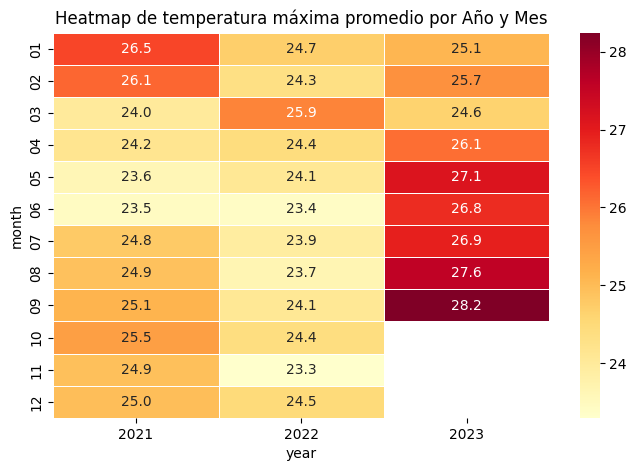

In [31]:
heatmap_data_max = df_temperatura.pivot_table(
    columns="year", index="month", values="temp_max", aggfunc="mean"
)

# Create a heatmap
plt.figure(figsize=(8, 5))
sns.heatmap(heatmap_data_max, annot=True, fmt=".1f", cmap="YlOrRd", linewidths=0.5)
plt.title("Heatmap de temperatura máxima promedio por Año y Mes")
plt.show()

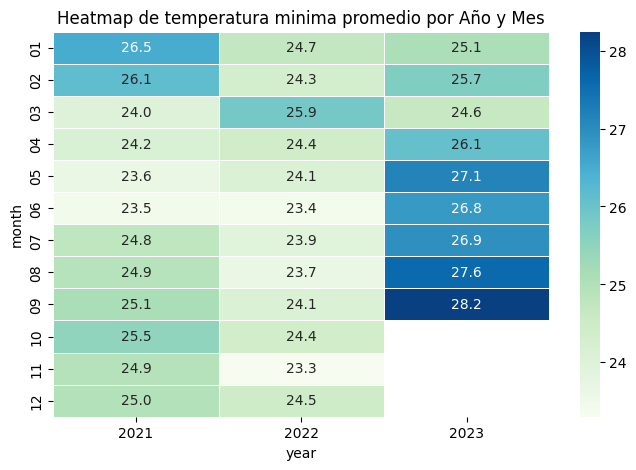

In [32]:
heatmap_data_min = df_temperatura.pivot_table(
    columns="year", index="month", values="temp_min", aggfunc="mean"
)

# Create a heatmap
plt.figure(figsize=(8, 5))
sns.heatmap(heatmap_data_max, annot=True, fmt=".1f", cmap="GnBu", linewidths=0.5)
plt.title("Heatmap de temperatura minima promedio por Año y Mes")
plt.show()

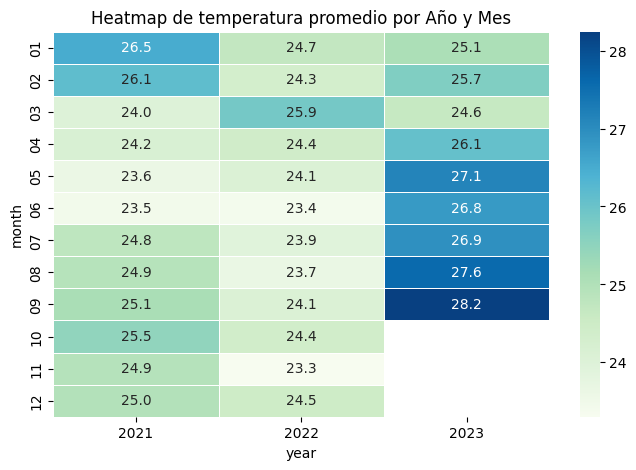

In [33]:
heatmap_data_min = df_temperatura.pivot_table(
    columns="year", index="month", values="temp_prom", aggfunc="mean"
)

# Create a heatmap
plt.figure(figsize=(8, 5))
sns.heatmap(heatmap_data_max, annot=True, fmt=".1f", cmap="GnBu", linewidths=0.5)
plt.title("Heatmap de temperatura promedio por Año y Mes")
plt.show()

### Analizando consistencia temporal de los datos

In [34]:
fig = px.bar(
    df_temperatura.groupby(["Year-Month"])[["temp_min","temp_max"]].mean().reset_index(),
    x="Year-Month",
    y=["temp_max","temp_min"],
    title="Temperatura máxima y mínima por Year-Month",
    barmode="group"
)
fig.show()

In [35]:
# Gráfica 1
df_diario = (
    df_temperatura.groupby(["date", "departamento"])[["temp_min","temp_max","temp_prom"]].mean().reset_index()
)



lista_departamentos_grafica1 = df_diario["departamento"].unique()

app1 = dash.Dash(__name__)

app1.layout = html.Div(
    [
        dcc.Dropdown(
            id="departamento-dropdown-grafica1",
            options=[
                {"label": departamento, "value": departamento}
                for departamento in lista_departamentos_grafica1
            ],
            value=lista_departamentos_grafica1[0],
            multi=False,
        ),
        dcc.Graph(id="graph1"),
    ]
)


@app1.callback(
    Output("graph1", "figure"), [Input("departamento-dropdown-grafica1", "value")]
)
def update_graph1(selected_departamento):
    df_selected_departamento = df_diario[
        df_diario["departamento"] == selected_departamento
    ]

    df_pivot = df_selected_departamento.pivot(
        index="date", columns="departamento", values="temp_max"
    ).reset_index()

    df_pivot["year"] = df_pivot["date"].dt.year
    df_pivot["month"] = df_pivot["date"].dt.month

    fig1 = px.line(
        df_pivot,
        x="date",
        y=selected_departamento,
        color="year",
        labels={selected_departamento: "Temperatura máxima"},
        title=f"Temperatura máxima promedio en {selected_departamento}",
    )

    return fig1



# Ejecutar la aplicación
if __name__ == "__main__":
    app1.run_server(debug=True, port=8050)

In [36]:
# Gráfica 2

app1 = dash.Dash(__name__)

app1.layout = html.Div(
    [
        dcc.Dropdown(
            id="departamento-dropdown-grafica1",
            options=[
                {"label": departamento, "value": departamento}
                for departamento in lista_departamentos_grafica1
            ],
            value=lista_departamentos_grafica1[0],
            multi=False,
        ),
        dcc.Graph(id="graph1"),
    ]
)


@app1.callback(
    Output("graph1", "figure"), [Input("departamento-dropdown-grafica1", "value")]
)
def update_graph1(selected_departamento):
    df_selected_departamento = df_diario[
        df_diario["departamento"] == selected_departamento
    ]

    df_pivot = df_selected_departamento.pivot(
        index="date", columns="departamento", values="temp_min"
    ).reset_index()

    df_pivot["year"] = df_pivot["date"].dt.year
    df_pivot["month"] = df_pivot["date"].dt.month

    fig1 = px.line(
        df_pivot,
        x="date",
        y=selected_departamento,
        color="year",
        labels={selected_departamento: "Temperatura minima"},
        title=f"Temperatura minima promedio en {selected_departamento}",
    )

    return fig1



# Ejecutar la aplicación
if __name__ == "__main__":
    app1.run_server(debug=True, port=8051)

### Analisis geográfico de la temperatura

In [37]:
# Load the GeoJSON file with department boundaries
geojson_path = 'geojson/co_2018_MGN_DPTO_POLITICO.geojson'  # Replace with the actual path
departments = gpd.read_file(geojson_path)
departments.head()

,DPTO_CCDGO,DPTO_CNMBR,DPTO_NANO_,DPTO_CACTO,DPTO_NANO,Shape_Leng,Shape_Area,geometry
0,18,CAQUETÁ,1981,Ley 78 del 29 de Diciembre de 1981,2018,21.384287,7.318485,"POLYGON ((-73.65989 1.61210, -73.65867 1.57615..."
1,19,CAUCA,1857,15 de junio de 1857,2018,13.950263,2.534419,"POLYGON ((-76.05556 3.22341, -76.09106 3.19862..."
2,86,PUTUMAYO,1991,Articulo 309 Constitucion Politica de 1991,2018,12.707922,2.107965,"POLYGON ((-76.08494 1.05806, -75.97599 1.06178..."
3,76,VALLE DEL CAUCA,1910,Decreto No 340 de 16 de Abril de 1910,2018,12.650870,1.679487,"POLYGON ((-75.71402 4.71325, -75.70667 4.65748..."
4,94,GUAINÍA,1991,Articulo 309 Constitucion Politica de 1991,2018,21.179051,5.747937,"POLYGON ((-69.84544 1.71374, -69.90175 1.74224..."


## Creando DataFrame Final

In [38]:
df_temperatura_curated = df_temperatura.drop(columns=["year", "month", "Year-Month"])
df_temperatura_curated.head()

,date,departamento,municipio,latitud,longitud,temp_max,temp_min,temp_prom
0,2023-02-13,CALDAS,MANIZALES,5.044997222,-75.33221944,11.76996,3.194234,7.482097
1,2021-02-16,SANTANDER,CHARALÁ,6.274,-73.151,28.70000,16.900000,22.800000
2,2022-08-03,NORTE DE SANTANDER,GRAMALOTE,7.923163889,-72.83375556,22.89349,15.377090,19.135290
3,2022-07-23,VALLE DEL CAUCA,CAICEDONIA,4.297558333,-75.86396111,25.46039,17.622430,21.541410
4,2022-04-04,BOYACA,PÁEZ,5.096,-73.053,23.45000,17.940000,20.695000


### Calculando temperatura máxima promedio por departamento y fecha

In [39]:
grouped_df = (
    df_temperatura_curated.groupby(["date", "departamento"])["temp_max"].mean().reset_index()
)
grouped_df

,date,departamento,temp_max
0,2021-01-01,AMAZONAS,31.550000
1,2021-01-01,ANTIOQUIA,25.420967
2,2021-01-01,ARAUCA,5.200000
3,2021-01-01,ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA...,30.400000
4,2021-01-01,ATLANTICO,30.700000
...,...,...,...
27108,2023-09-30,QUINDIO,31.700000
27109,2023-09-30,RISARALDA,29.500000
27110,2023-09-30,SANTANDER,30.375000
27111,2023-09-30,SUCRE,33.950000


### Pivoteando la tabla para tener una fila por fecha

In [40]:
# Step 2: Pivot the table
pivot_df = grouped_df.pivot(
    index="date", columns="departamento", values="temp_max"
).reset_index()
pivot_df

departamento,date,AMAZONAS,ANTIOQUIA,ARAUCA,ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA,ATLANTICO,BOGOTA,BOLIVAR,BOYACA,CALDAS,...,NARINO,NORTE DE SANTANDER,PUTUMAYO,QUINDIO,RISARALDA,SANTANDER,SUCRE,TOLIMA,VALLE DEL CAUCA,VICHADA
0,2021-01-01,31.55,25.420967,5.200000,30.400,30.700,18.400000,38.133333,19.679443,26.625405,...,25.078390,21.681315,NaN,27.545003,27.104734,24.363469,34.200000,27.225654,27.402849,NaN
1,2021-01-02,30.50,26.882303,3.600000,29.400,30.850,18.800000,38.400000,20.031556,27.392011,...,23.908482,19.816360,NaN,27.945297,27.167800,24.619403,34.033333,27.573329,27.042640,NaN
2,2021-01-03,31.05,25.902895,8.000000,28.500,30.900,19.600000,36.266667,20.524683,26.731011,...,26.104662,20.283625,NaN,26.574387,26.015089,24.150770,34.200000,23.995194,25.860071,NaN
3,2021-01-04,29.10,20.804770,6.800000,28.900,28.300,12.900000,35.350000,15.809514,22.231421,...,18.941357,17.715310,NaN,21.661557,22.182261,20.153424,27.866667,22.473339,22.429997,NaN
4,2021-01-09,31.80,24.598111,19.033333,28.900,30.900,19.266667,32.725000,18.455256,24.884429,...,23.534404,23.307219,NaN,26.209610,24.494615,20.806425,33.133333,25.449357,26.194990,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
952,2023-09-26,29.05,26.525000,6.700000,33.900,34.275,23.600000,32.233333,21.500000,NaN,...,20.033333,36.450000,32.6,29.950000,29.200000,29.820000,31.400000,30.483333,NaN,35.2
953,2023-09-27,34.25,25.875000,7.200000,33.325,34.600,23.200000,32.800000,21.292222,NaN,...,21.616667,32.450000,33.3,30.300000,30.950000,27.900000,31.900000,31.266667,NaN,31.0
954,2023-09-28,34.40,25.800000,6.000000,33.350,34.650,22.800000,32.866667,21.012500,NaN,...,18.950000,32.550000,29.7,26.150000,24.100000,29.925000,33.000000,27.416667,NaN,NaN
955,2023-09-29,32.45,27.625000,6.200000,32.725,35.850,22.500000,33.866667,19.004444,NaN,...,18.700000,32.250000,29.0,31.400000,31.650000,29.550000,33.900000,29.666667,NaN,NaN


### Llenando las fechas que hacen falta en el dataframe

In [41]:
# Completar el DataFrame con fechas continuas
df_continuo = pivot_df.copy()

fechas_continuas = pd.date_range(
    start=df_continuo["date"].min(), end=df_continuo["date"].max(), freq="D"
)

df_continuo = pd.DataFrame({"date": fechas_continuas}).drop_duplicates()

# Combinar el DataFrame continuo con el DataFrame original
df_continuo = pd.merge(df_continuo, pivot_df, on="date", how="left")

df_continuo.head(10)

,date,AMAZONAS,ANTIOQUIA,ARAUCA,ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA,ATLANTICO,BOGOTA,BOLIVAR,BOYACA,CALDAS,...,NARINO,NORTE DE SANTANDER,PUTUMAYO,QUINDIO,RISARALDA,SANTANDER,SUCRE,TOLIMA,VALLE DEL CAUCA,VICHADA
0,2021-01-01,31.55,25.420967,5.200000,30.4,30.70,18.400000,38.133333,19.679443,26.625405,...,25.078390,21.681315,NaN,27.545003,27.104734,24.363469,34.200000,27.225654,27.402849,NaN
1,2021-01-02,30.50,26.882303,3.600000,29.4,30.85,18.800000,38.400000,20.031556,27.392011,...,23.908482,19.816360,NaN,27.945297,27.167800,24.619403,34.033333,27.573329,27.042640,NaN
2,2021-01-03,31.05,25.902895,8.000000,28.5,30.90,19.600000,36.266667,20.524683,26.731011,...,26.104662,20.283625,NaN,26.574387,26.015089,24.150770,34.200000,23.995194,25.860071,NaN
3,2021-01-04,29.10,20.804770,6.800000,28.9,28.30,12.900000,35.350000,15.809514,22.231421,...,18.941357,17.715310,NaN,21.661557,22.182261,20.153424,27.866667,22.473339,22.429997,NaN
4,2021-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,2021-01-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,2021-01-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,2021-01-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2021-01-09,31.80,24.598111,19.033333,28.9,30.90,19.266667,32.725000,18.455256,24.884429,...,23.534404,23.307219,NaN,26.209610,24.494615,20.806425,33.133333,25.449357,26.194990,NaN
9,2021-01-10,32.25,26.983030,20.233333,29.8,31.90,18.533333,33.450000,19.967838,26.585965,...,24.052554,23.934229,NaN,28.158010,27.065754,23.021466,33.900000,26.623829,28.393411,NaN


### Imputando missing values

#### Evaluando SimpleImputer con la media y seasonal descompose

In [42]:
## Imputando datos faltantes

df=df_continuo.set_index("date")

# Impute missing values using SimpleImputer only for the missing values
imputer = SimpleImputer(strategy='mean', missing_values=float('nan'))
df_imputed = pd.DataFrame(imputer.fit_transform(df), columns=df.columns, index=df.index)

# Seasonal decomposition using statsmodels
for column in df_imputed.columns:
    result = seasonal_decompose(df_imputed[column], model='additive', extrapolate_trend='freq', period=365)
    df_imputed[column] = df_imputed[column].combine_first(result.trend + result.seasonal)

# Display the imputed DataFrame
df_imputed.head(10)

,AMAZONAS,ANTIOQUIA,ARAUCA,ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA,ATLANTICO,BOGOTA,BOLIVAR,BOYACA,CALDAS,CAQUETA,...,NARINO,NORTE DE SANTANDER,PUTUMAYO,QUINDIO,RISARALDA,SANTANDER,SUCRE,TOLIMA,VALLE DEL CAUCA,VICHADA
date,,,,,,,,,,,,,,,,,,,,,
2021-01-01,31.550000,25.420967,5.200000,30.400000,30.700000,18.400000,38.133333,19.679443,26.625405,24.742620,...,25.078390,21.681315,27.877821,27.545003,27.104734,24.363469,34.200000,27.225654,27.402849,31.009231
2021-01-02,30.500000,26.882303,3.600000,29.400000,30.850000,18.800000,38.400000,20.031556,27.392011,23.922760,...,23.908482,19.816360,27.877821,27.945297,27.167800,24.619403,34.033333,27.573329,27.042640,31.009231
2021-01-03,31.050000,25.902895,8.000000,28.500000,30.900000,19.600000,36.266667,20.524683,26.731011,24.437030,...,26.104662,20.283625,27.877821,26.574387,26.015089,24.150770,34.200000,23.995194,25.860071,31.009231
2021-01-04,29.100000,20.804770,6.800000,28.900000,28.300000,12.900000,35.350000,15.809514,22.231421,25.034490,...,18.941357,17.715310,27.877821,21.661557,22.182261,20.153424,27.866667,22.473339,22.429997,31.009231
2021-01-05,29.876582,25.348907,11.914956,30.497094,32.671067,18.605614,32.155510,19.994313,22.797663,28.629756,...,20.909872,25.669596,27.877821,26.155205,26.179868,23.930614,33.370853,26.168399,26.897230,31.009231
2021-01-06,29.876582,25.348907,11.914956,30.497094,32.671067,18.605614,32.155510,19.994313,22.797663,28.629756,...,20.909872,25.669596,27.877821,26.155205,26.179868,23.930614,33.370853,26.168399,26.897230,31.009231
2021-01-07,29.876582,25.348907,11.914956,30.497094,32.671067,18.605614,32.155510,19.994313,22.797663,28.629756,...,20.909872,25.669596,27.877821,26.155205,26.179868,23.930614,33.370853,26.168399,26.897230,31.009231
2021-01-08,29.876582,25.348907,11.914956,30.497094,32.671067,18.605614,32.155510,19.994313,22.797663,28.629756,...,20.909872,25.669596,27.877821,26.155205,26.179868,23.930614,33.370853,26.168399,26.897230,31.009231
2021-01-09,31.800000,24.598111,19.033333,28.900000,30.900000,19.266667,32.725000,18.455256,24.884429,26.701270,...,23.534404,23.307219,27.877821,26.209610,24.494615,20.806425,33.133333,25.449357,26.194990,31.009231


In [43]:
df_imputed

,AMAZONAS,ANTIOQUIA,ARAUCA,ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA,ATLANTICO,BOGOTA,BOLIVAR,BOYACA,CALDAS,CAQUETA,...,NARINO,NORTE DE SANTANDER,PUTUMAYO,QUINDIO,RISARALDA,SANTANDER,SUCRE,TOLIMA,VALLE DEL CAUCA,VICHADA
date,,,,,,,,,,,,,,,,,,,,,
2021-01-01,31.550000,25.420967,5.200000,30.400000,30.700000,18.400000,38.133333,19.679443,26.625405,24.742620,...,25.078390,21.681315,27.877821,27.545003,27.104734,24.363469,34.200000,27.225654,27.402849,31.009231
2021-01-02,30.500000,26.882303,3.600000,29.400000,30.850000,18.800000,38.400000,20.031556,27.392011,23.922760,...,23.908482,19.816360,27.877821,27.945297,27.167800,24.619403,34.033333,27.573329,27.042640,31.009231
2021-01-03,31.050000,25.902895,8.000000,28.500000,30.900000,19.600000,36.266667,20.524683,26.731011,24.437030,...,26.104662,20.283625,27.877821,26.574387,26.015089,24.150770,34.200000,23.995194,25.860071,31.009231
2021-01-04,29.100000,20.804770,6.800000,28.900000,28.300000,12.900000,35.350000,15.809514,22.231421,25.034490,...,18.941357,17.715310,27.877821,21.661557,22.182261,20.153424,27.866667,22.473339,22.429997,31.009231
2021-01-05,29.876582,25.348907,11.914956,30.497094,32.671067,18.605614,32.155510,19.994313,22.797663,28.629756,...,20.909872,25.669596,27.877821,26.155205,26.179868,23.930614,33.370853,26.168399,26.897230,31.009231
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-09-26,29.050000,26.525000,6.700000,33.900000,34.275000,23.600000,32.233333,21.500000,22.797663,34.400000,...,20.033333,36.450000,32.600000,29.950000,29.200000,29.820000,31.400000,30.483333,26.897230,35.200000
2023-09-27,34.250000,25.875000,7.200000,33.325000,34.600000,23.200000,32.800000,21.292222,22.797663,34.200000,...,21.616667,32.450000,33.300000,30.300000,30.950000,27.900000,31.900000,31.266667,26.897230,31.000000
2023-09-28,34.400000,25.800000,6.000000,33.350000,34.650000,22.800000,32.866667,21.012500,22.797663,31.600000,...,18.950000,32.550000,29.700000,26.150000,24.100000,29.925000,33.000000,27.416667,26.897230,31.009231


In [44]:
df_test=df_imputed[["ANTIOQUIA"]].reset_index()
df_test

,date,ANTIOQUIA
0,2021-01-01,25.420967
1,2021-01-02,26.882303
2,2021-01-03,25.902895
3,2021-01-04,20.804770
4,2021-01-05,25.348907
...,...,...
998,2023-09-26,26.525000
999,2023-09-27,25.875000
1000,2023-09-28,25.800000
1001,2023-09-29,27.625000


In [45]:
df_imputed

,AMAZONAS,ANTIOQUIA,ARAUCA,ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA,ATLANTICO,BOGOTA,BOLIVAR,BOYACA,CALDAS,CAQUETA,...,NARINO,NORTE DE SANTANDER,PUTUMAYO,QUINDIO,RISARALDA,SANTANDER,SUCRE,TOLIMA,VALLE DEL CAUCA,VICHADA
date,,,,,,,,,,,,,,,,,,,,,
2021-01-01,31.550000,25.420967,5.200000,30.400000,30.700000,18.400000,38.133333,19.679443,26.625405,24.742620,...,25.078390,21.681315,27.877821,27.545003,27.104734,24.363469,34.200000,27.225654,27.402849,31.009231
2021-01-02,30.500000,26.882303,3.600000,29.400000,30.850000,18.800000,38.400000,20.031556,27.392011,23.922760,...,23.908482,19.816360,27.877821,27.945297,27.167800,24.619403,34.033333,27.573329,27.042640,31.009231
2021-01-03,31.050000,25.902895,8.000000,28.500000,30.900000,19.600000,36.266667,20.524683,26.731011,24.437030,...,26.104662,20.283625,27.877821,26.574387,26.015089,24.150770,34.200000,23.995194,25.860071,31.009231
2021-01-04,29.100000,20.804770,6.800000,28.900000,28.300000,12.900000,35.350000,15.809514,22.231421,25.034490,...,18.941357,17.715310,27.877821,21.661557,22.182261,20.153424,27.866667,22.473339,22.429997,31.009231
2021-01-05,29.876582,25.348907,11.914956,30.497094,32.671067,18.605614,32.155510,19.994313,22.797663,28.629756,...,20.909872,25.669596,27.877821,26.155205,26.179868,23.930614,33.370853,26.168399,26.897230,31.009231
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-09-26,29.050000,26.525000,6.700000,33.900000,34.275000,23.600000,32.233333,21.500000,22.797663,34.400000,...,20.033333,36.450000,32.600000,29.950000,29.200000,29.820000,31.400000,30.483333,26.897230,35.200000
2023-09-27,34.250000,25.875000,7.200000,33.325000,34.600000,23.200000,32.800000,21.292222,22.797663,34.200000,...,21.616667,32.450000,33.300000,30.300000,30.950000,27.900000,31.900000,31.266667,26.897230,31.000000
2023-09-28,34.400000,25.800000,6.000000,33.350000,34.650000,22.800000,32.866667,21.012500,22.797663,31.600000,...,18.950000,32.550000,29.700000,26.150000,24.100000,29.925000,33.000000,27.416667,26.897230,31.009231


In [46]:
# Gráfica 3
app1 = dash.Dash(__name__)

app1.layout = html.Div(
    [
        dcc.Dropdown(
            id="departamento-dropdown-grafica1",
            options=[
                {"label": departamento, "value": departamento}
                for departamento in lista_departamentos_grafica1
            ],
            value=lista_departamentos_grafica1[0],
            multi=False,
        ),
        dcc.Graph(id="graph1"),
    ]
)


@app1.callback(
    Output("graph1", "figure"), [Input("departamento-dropdown-grafica1", "value")]
)
def update_graph1(selected_departamento):
    
    df_pivot = df_imputed[[selected_departamento]].reset_index()

    df_pivot["year"] = df_pivot["date"].dt.year
    df_pivot["month"] = df_pivot["date"].dt.month

    fig1 = px.line(
        df_pivot,
        x="date",
        y=selected_departamento,
        color="year",
        labels={selected_departamento: "Temperatura máxima"},
        title=f"Temperatura máxima promedio en {selected_departamento} con SimpleImputation",
    )

    return fig1

# Ejecutar la aplicación
if __name__ == "__main__":
    app1.run_server(debug=True, port=8053)

#### Evaluando KNN Imputer con la media y KNN Imputer

In [47]:
## Imputando datos faltantes

df_knn=df_continuo.set_index("date")

# Seleccionar solo las columnas numéricas para la imputación
columns_to_impute = df_knn.columns


# Impute missing values using KNNImputer only for the missing values
knn_imputer = KNNImputer(n_neighbors=5)  # You can adjust the number of neighbors

# Aplicar la imputación solo a las columnas numéricas
df_knn[columns_to_impute] = knn_imputer.fit_transform(
    df_knn[columns_to_impute]
)



# Display the imputed DataFrame
df_knn.head(10)

,AMAZONAS,ANTIOQUIA,ARAUCA,ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA,ATLANTICO,BOGOTA,BOLIVAR,BOYACA,CALDAS,CAQUETA,...,NARINO,NORTE DE SANTANDER,PUTUMAYO,QUINDIO,RISARALDA,SANTANDER,SUCRE,TOLIMA,VALLE DEL CAUCA,VICHADA
date,,,,,,,,,,,,,,,,,,,,,
2021-01-01,31.550000,25.420967,5.200000,30.400000,30.700000,18.400000,38.133333,19.679443,26.625405,24.742620,...,25.078390,21.681315,27.520000,27.545003,27.104734,24.363469,34.200000,27.225654,27.402849,32.760000
2021-01-02,30.500000,26.882303,3.600000,29.400000,30.850000,18.800000,38.400000,20.031556,27.392011,23.922760,...,23.908482,19.816360,27.520000,27.945297,27.167800,24.619403,34.033333,27.573329,27.042640,33.000000
2021-01-03,31.050000,25.902895,8.000000,28.500000,30.900000,19.600000,36.266667,20.524683,26.731011,24.437030,...,26.104662,20.283625,29.140000,26.574387,26.015089,24.150770,34.200000,23.995194,25.860071,33.020000
2021-01-04,29.100000,20.804770,6.800000,28.900000,28.300000,12.900000,35.350000,15.809514,22.231421,25.034490,...,18.941357,17.715310,24.920000,21.661557,22.182261,20.153424,27.866667,22.473339,22.429997,28.560000
2021-01-05,29.876582,25.348907,11.914956,30.497094,32.671067,18.605614,32.155510,19.994313,22.797663,28.629756,...,20.909872,25.669596,27.877821,26.155205,26.179868,23.930614,33.370853,26.168399,26.897230,31.009231
2021-01-06,29.876582,25.348907,11.914956,30.497094,32.671067,18.605614,32.155510,19.994313,22.797663,28.629756,...,20.909872,25.669596,27.877821,26.155205,26.179868,23.930614,33.370853,26.168399,26.897230,31.009231
2021-01-07,29.876582,25.348907,11.914956,30.497094,32.671067,18.605614,32.155510,19.994313,22.797663,28.629756,...,20.909872,25.669596,27.877821,26.155205,26.179868,23.930614,33.370853,26.168399,26.897230,31.009231
2021-01-08,29.876582,25.348907,11.914956,30.497094,32.671067,18.605614,32.155510,19.994313,22.797663,28.629756,...,20.909872,25.669596,27.877821,26.155205,26.179868,23.930614,33.370853,26.168399,26.897230,31.009231
2021-01-09,31.800000,24.598111,19.033333,28.900000,30.900000,19.266667,32.725000,18.455256,24.884429,26.701270,...,23.534404,23.307219,26.180000,26.209610,24.494615,20.806425,33.133333,25.449357,26.194990,30.460000


In [48]:
# Gráfica 4
app1 = dash.Dash(__name__)

app1.layout = html.Div(
    [
        dcc.Dropdown(
            id="departamento-dropdown-grafica1",
            options=[
                {"label": departamento, "value": departamento}
                for departamento in lista_departamentos_grafica1
            ],
            value=lista_departamentos_grafica1[0],
            multi=False,
        ),
        dcc.Graph(id="graph1"),
    ]
)


@app1.callback(
    Output("graph1", "figure"), [Input("departamento-dropdown-grafica1", "value")]
)
def update_graph1(selected_departamento):
    
    df_pivot = df_knn[[selected_departamento]].reset_index()

    df_pivot["year"] = df_pivot["date"].dt.year
    df_pivot["month"] = df_pivot["date"].dt.month

    fig1 = px.line(
        df_pivot,
        x="date",
        y=selected_departamento,
        color="year",
        labels={selected_departamento: "Temperatura máxima"},
        title=f"Temperatura máxima promedio en {selected_departamento} con KNN Imputation",
    )

    return fig1

# Ejecutar la aplicación
if __name__ == "__main__":
    app1.run_server(debug=True, port=8054)

##### **Después de analizar los gráficos con los datos imputados, se puede concluir que el método KNN Imputation es más efectivo, y por lo tanto, se va a conservar esta data**

#### Calculando columnas adicionales y guardando el csv con los resultados

In [49]:
df_temp=df_knn.reset_index()

# Calculando la temperatura promedio para todo el país
temp_columns = [col for col in df_temp.columns if col != "date"]
df_temp["temp_avg_pais"] = df_temp[temp_columns].mean(axis=1)

df_temp.head()

,date,AMAZONAS,ANTIOQUIA,ARAUCA,ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA,ATLANTICO,BOGOTA,BOLIVAR,BOYACA,CALDAS,...,NORTE DE SANTANDER,PUTUMAYO,QUINDIO,RISARALDA,SANTANDER,SUCRE,TOLIMA,VALLE DEL CAUCA,VICHADA,temp_avg_pais
0,2021-01-01,31.550000,25.420967,5.200000,30.400000,30.700000,18.400000,38.133333,19.679443,26.625405,...,21.681315,27.520000,27.545003,27.104734,24.363469,34.200000,27.225654,27.402849,32.760000,27.614309
1,2021-01-02,30.500000,26.882303,3.600000,29.400000,30.850000,18.800000,38.400000,20.031556,27.392011,...,19.816360,27.520000,27.945297,27.167800,24.619403,34.033333,27.573329,27.042640,33.000000,27.444911
2,2021-01-03,31.050000,25.902895,8.000000,28.500000,30.900000,19.600000,36.266667,20.524683,26.731011,...,20.283625,29.140000,26.574387,26.015089,24.150770,34.200000,23.995194,25.860071,33.020000,27.221717
3,2021-01-04,29.100000,20.804770,6.800000,28.900000,28.300000,12.900000,35.350000,15.809514,22.231421,...,17.715310,24.920000,21.661557,22.182261,20.153424,27.866667,22.473339,22.429997,28.560000,23.588037
4,2021-01-05,29.876582,25.348907,11.914956,30.497094,32.671067,18.605614,32.155510,19.994313,22.797663,...,25.669596,27.877821,26.155205,26.179868,23.930614,33.370853,26.168399,26.897230,31.009231,27.122750


In [50]:
# Calculando la temperatura promedio de los departamentos que tiene represas hidraulicas

list_dptos_represas=["ANTIOQUIA", "VALLE DEL CAUCA","HUILA","SANTANDER","TOLIMA",
                    "CUNDINAMARCA","BOYACA","CALDAS","CAUCA","CORDOBA"]

# Calculando la temperatura promedio para todo el país
temp_columns = [col for col in list_dptos_represas]

print(df_temp[temp_columns].columns)
df_temp["temp_avg_represas"] = df_temp[temp_columns].mean(axis=1)

df_temp.head()

Index(['ANTIOQUIA', 'VALLE DEL CAUCA', 'HUILA', 'SANTANDER', 'TOLIMA',
       'CUNDINAMARCA', 'BOYACA', 'CALDAS', 'CAUCA', 'CORDOBA'],
      dtype='object')


,date,AMAZONAS,ANTIOQUIA,ARAUCA,ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA,ATLANTICO,BOGOTA,BOLIVAR,BOYACA,CALDAS,...,PUTUMAYO,QUINDIO,RISARALDA,SANTANDER,SUCRE,TOLIMA,VALLE DEL CAUCA,VICHADA,temp_avg_pais,temp_avg_represas
0,2021-01-01,31.550000,25.420967,5.200000,30.400000,30.700000,18.400000,38.133333,19.679443,26.625405,...,27.520000,27.545003,27.104734,24.363469,34.200000,27.225654,27.402849,32.760000,27.614309,25.485065
1,2021-01-02,30.500000,26.882303,3.600000,29.400000,30.850000,18.800000,38.400000,20.031556,27.392011,...,27.520000,27.945297,27.167800,24.619403,34.033333,27.573329,27.042640,33.000000,27.444911,25.743014
2,2021-01-03,31.050000,25.902895,8.000000,28.500000,30.900000,19.600000,36.266667,20.524683,26.731011,...,29.140000,26.574387,26.015089,24.150770,34.200000,23.995194,25.860071,33.020000,27.221717,25.035134
3,2021-01-04,29.100000,20.804770,6.800000,28.900000,28.300000,12.900000,35.350000,15.809514,22.231421,...,24.920000,21.661557,22.182261,20.153424,27.866667,22.473339,22.429997,28.560000,23.588037,20.446274
4,2021-01-05,29.876582,25.348907,11.914956,30.497094,32.671067,18.605614,32.155510,19.994313,22.797663,...,27.877821,26.155205,26.179868,23.930614,33.370853,26.168399,26.897230,31.009231,27.122750,24.738323


In [51]:
# Renombrando las columnas
df_temp.columns = (
    ["date"]
    + ["temp_" + col for col in pivot_df.columns if col != "date" and col != "temp_avg_pais" and col != "temp_avg_represas"]
    + ["temp_avg_pais"]
    + ["temp_avg_represas"]
)
df_temp.head()

,date,temp_AMAZONAS,temp_ANTIOQUIA,temp_ARAUCA,temp_ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA,temp_ATLANTICO,temp_BOGOTA,temp_BOLIVAR,temp_BOYACA,temp_CALDAS,...,temp_PUTUMAYO,temp_QUINDIO,temp_RISARALDA,temp_SANTANDER,temp_SUCRE,temp_TOLIMA,temp_VALLE DEL CAUCA,temp_VICHADA,temp_avg_pais,temp_avg_represas
0,2021-01-01,31.550000,25.420967,5.200000,30.400000,30.700000,18.400000,38.133333,19.679443,26.625405,...,27.520000,27.545003,27.104734,24.363469,34.200000,27.225654,27.402849,32.760000,27.614309,25.485065
1,2021-01-02,30.500000,26.882303,3.600000,29.400000,30.850000,18.800000,38.400000,20.031556,27.392011,...,27.520000,27.945297,27.167800,24.619403,34.033333,27.573329,27.042640,33.000000,27.444911,25.743014
2,2021-01-03,31.050000,25.902895,8.000000,28.500000,30.900000,19.600000,36.266667,20.524683,26.731011,...,29.140000,26.574387,26.015089,24.150770,34.200000,23.995194,25.860071,33.020000,27.221717,25.035134
3,2021-01-04,29.100000,20.804770,6.800000,28.900000,28.300000,12.900000,35.350000,15.809514,22.231421,...,24.920000,21.661557,22.182261,20.153424,27.866667,22.473339,22.429997,28.560000,23.588037,20.446274
4,2021-01-05,29.876582,25.348907,11.914956,30.497094,32.671067,18.605614,32.155510,19.994313,22.797663,...,27.877821,26.155205,26.179868,23.930614,33.370853,26.168399,26.897230,31.009231,27.122750,24.738323


In [52]:
df_final=df_temp.copy()
print(df_final.shape)
print(df_final.dtypes)
df_final.head()

(1003, 35)
date                                                            datetime64[ns]
temp_AMAZONAS                                                          float64
temp_ANTIOQUIA                                                         float64
temp_ARAUCA                                                            float64
temp_ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA           float64
temp_ATLANTICO                                                         float64
temp_BOGOTA                                                            float64
temp_BOLIVAR                                                           float64
temp_BOYACA                                                            float64
temp_CALDAS                                                            float64
temp_CAQUETA                                                           float64
temp_CASANARE                                                          float64
temp_CAUCA                               

,date,temp_AMAZONAS,temp_ANTIOQUIA,temp_ARAUCA,temp_ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA,temp_ATLANTICO,temp_BOGOTA,temp_BOLIVAR,temp_BOYACA,temp_CALDAS,...,temp_PUTUMAYO,temp_QUINDIO,temp_RISARALDA,temp_SANTANDER,temp_SUCRE,temp_TOLIMA,temp_VALLE DEL CAUCA,temp_VICHADA,temp_avg_pais,temp_avg_represas
0,2021-01-01,31.550000,25.420967,5.200000,30.400000,30.700000,18.400000,38.133333,19.679443,26.625405,...,27.520000,27.545003,27.104734,24.363469,34.200000,27.225654,27.402849,32.760000,27.614309,25.485065
1,2021-01-02,30.500000,26.882303,3.600000,29.400000,30.850000,18.800000,38.400000,20.031556,27.392011,...,27.520000,27.945297,27.167800,24.619403,34.033333,27.573329,27.042640,33.000000,27.444911,25.743014
2,2021-01-03,31.050000,25.902895,8.000000,28.500000,30.900000,19.600000,36.266667,20.524683,26.731011,...,29.140000,26.574387,26.015089,24.150770,34.200000,23.995194,25.860071,33.020000,27.221717,25.035134
3,2021-01-04,29.100000,20.804770,6.800000,28.900000,28.300000,12.900000,35.350000,15.809514,22.231421,...,24.920000,21.661557,22.182261,20.153424,27.866667,22.473339,22.429997,28.560000,23.588037,20.446274
4,2021-01-05,29.876582,25.348907,11.914956,30.497094,32.671067,18.605614,32.155510,19.994313,22.797663,...,27.877821,26.155205,26.179868,23.930614,33.370853,26.168399,26.897230,31.009231,27.122750,24.738323


In [55]:
df_final.to_csv("processed_tables/temperatura.csv", index=False)